In [1]:
# Import Functions
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gp

In [3]:
import os
from pathlib import Path
currentDir = os.getcwd()
print(currentDir)

dataDir = os.path.join(currentDir, 'split_by_month_output/000')
print(dataDir)

parseDir = Path(dataDir).rglob('*.csv')
files = [x for x in parseDir]

/home/jeffmur/dev/urbanDataR/geolife
/home/jeffmur/dev/urbanDataR/geolife/split_by_month_output/000


In [6]:
dfs = [pd.read_table(f, sep = ",", names=['Latitude', 'Longitude', 'Zero', 'Altitude', 'Num of Days', 'Date', 'Time']) for f in files]

raw_concat = pd.concat(dfs, ignore_index=True)

raw_concat = raw_concat.drop(['Num of Days','Zero'], axis=1)

In [8]:
df = raw_users
df = df.replace(0, np.nan)
df = df.dropna(how='all', axis=0)
df = df.replace(np.nan, 0)

df

,Latitude,Longitude,Altitude,Date,Time
0,39.999976,116.326565,492.0,2008-11-03,10:13:36
1,40.000032,116.326175,492.0,2008-11-03,10:13:41
2,40.000038,116.326154,492.0,2008-11-03,10:13:46
3,40.000035,116.326081,492.0,2008-11-03,10:13:51
4,39.996877,116.326645,491.0,2008-11-03,10:15:51
...,...,...,...,...,...
173865,40.000734,116.327394,150.0,2009-06-30,14:27:21
173866,40.000735,116.327408,150.0,2009-06-30,14:27:26
173867,40.000739,116.327417,149.0,2009-06-30,14:27:31
173868,40.000778,116.327421,149.0,2009-06-30,14:27:36


In [9]:
# Create Bounding Box
maxLat = max(df['Latitude'])
minLat = min(df['Latitude'])
maxLon = max(df['Longitude'])
minLon = min(df['Longitude'])

print(f"Latidude \t Max: {maxLat}  \t Min: {minLat}")
print(f"Longitude \t Max: {maxLon} \t Min: {minLon}")

Latidude 	 Max: 40.21096  	 Min: 31.095299
Longitude 	 Max: 121.555706 	 Min: 116.071547


In [ ]:
# What is our range of collection?
totalMonth = len(files)


w: 115.4172086
s: 39.4416113
e: 117.5079852
n: 41.0595584
place: 北京市, China 中国
zoom: 10
n_tiles: 1


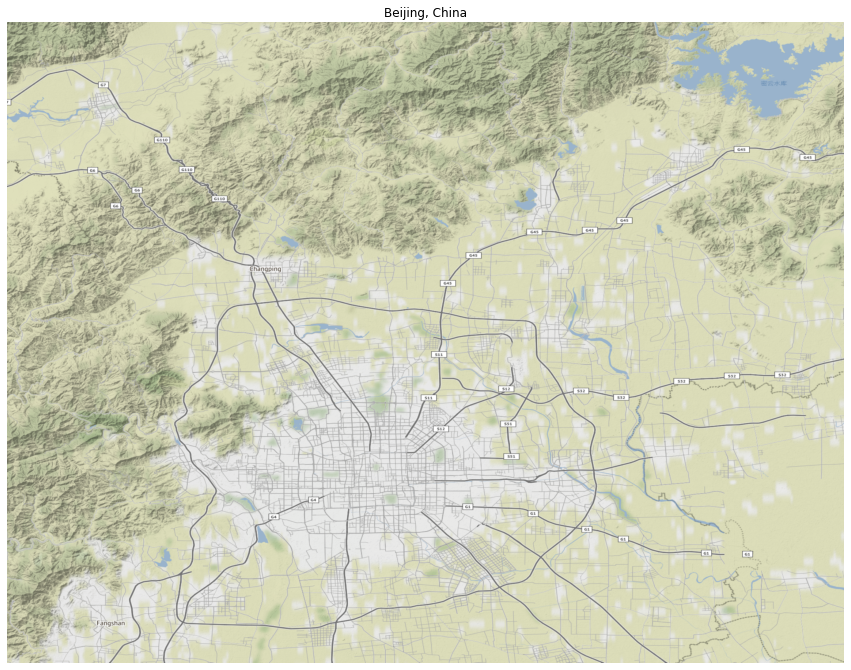

In [8]:
import contextily as ctx

# Longitude East  - West
# Latitude  North - South

loc = ctx.Place('beijing', zoom_adjust=1)  # zoom_adjust modifies the auto-zoom

# Print some metadata
for attr in ["w", "s", "e", "n", "place", "zoom", "n_tiles"]:
    print("{}: {}".format(attr, getattr(loc, attr)))

# Show the map
im1 = loc.im

fig, axs = plt.subplots(1, 1, figsize=(15, 15))
#ctx.plot_map(loc, ax=axs[0])

beijing_img, beijing_ext = ctx.bounds2img(loc.w+0.5, loc.s+0.2, loc.e-0.5, loc.n-0.5, zoom=11, ll=True)
beijing_img, beijing_ext = ctx.warp_tiles(beijing_img, beijing_ext, "EPSG:4326")

ctx.plot_map(beijing_img, beijing_ext, ax=axs, title="Beijing, China")

plt.show()

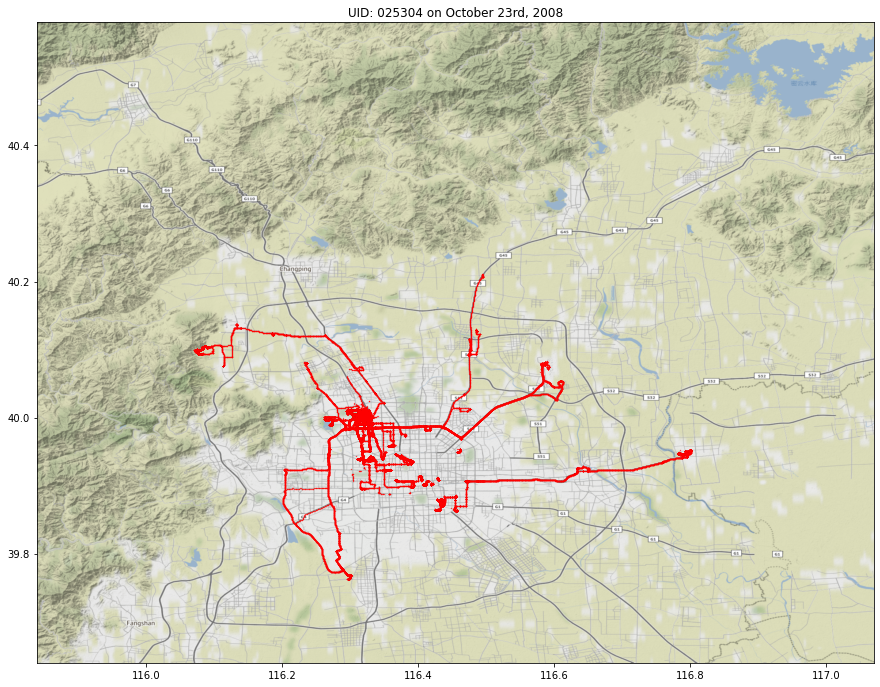

In [10]:
geometry = gp.points_from_xy(df['Longitude'], df['Latitude'])
geo_df = gp.GeoDataFrame(df, geometry = geometry)

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
geoLength = len(geo_df['geometry'])

xp = df[["Longitude"]].to_numpy()
yp = df[["Latitude"]].to_numpy()

# ax.set_xlim(116.2, 116.4)
# ax.set_ylim(39.95, 40.1)
ax.set_title('UID: 025304 on October 23rd, 2008')
ax.plot(xp, yp, markersize=0.3, marker='o', linestyle='none', color='red', alpha=1)
#geo_df.plot(ax=ax, linewidth=1, alpha=0.1)

ax.imshow(beijing_img, extent=beijing_ext)